## Model building
- CART
- OCT-H

In [2]:
using ScikitLearn, DecisionTree, CSV, DataFrames, CategoricalArrays

In [3]:
using MLJ, MLJModels

In [4]:
# Load the data
train = CSV.read("../../../1. Data Cleaning/Cleaned Datasets/Training_Set_grouped_binary.csv", DataFrame)[!, Not(:Column1)]
test = CSV.read("../../../1. Data Cleaning/Cleaned Datasets/Testing_Set_grouped_binary.csv", DataFrame)[!, Not(:Column1)]

X_train = train[:, Not(:readmitted)] 
y_train = Array(train[!, :readmitted])

X_test = test[:, Not(:readmitted)]  # Exclude 'readmitted' column
y_test = Array(test[!, :readmitted])

seed = 42

42

### CART - all features

In [5]:
grid_cart = IAI.GridSearch(IAI.OptimalTreeClassifier(random_seed=seed, 
                    localsearch=false,  
                    max_categoric_levels_before_warning=15), 
    criterion=:gini, max_depth = [5, 10], minbucket = [10, 50, 100])

IAI.fit_cv!(grid_cart, X_train, y_train, validation_criterion = :auc, n_folds=5)

[ Warning: This copy of Interpretable AI software is for academic purposes only and not for commercial use.
┌ Warning: Interpretable AI license expires soon: 2023-12-31T00:00:00. If you need to renew, please send us the following machine ID:
└ 15864244db72120092f2f63c4152e3aecd5018a2835981d5066b19d0faab1120


All Grid Results:

 Row │ minbucket  criterion  max_depth  cp           split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp    split2_cp    split3_cp    split4_cp    split5_cp    mean_cp      std_cp      overall_valid_score  rank_valid_score
     │ Int64      Symbol     Int64      Float64      Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64      Float64      Float64      Float64      Float64      Float64      Float64     Float64              Int64
─────┼─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │        10  gini               5  0.000122401           0.0855328           0.0833733           0.085706            0.0863607           0.0874373         0.085682        0.00149121            0.658214            0.669544            0.660239            0.655755            0.650909          0.658932       0.00687932  0.000101914  0.000120438  4.39103e-5   0.000152811  5.76086e-5   9.53363e-5   4.48461e-5             0.658904                 5
   2 │        10  gini              10  0.000166194           0.133183            0.132807            0.133682            0.133197            0.13476           0.133526        0.0007567             0.667194            0.677409            0.669291            0.664807            0.661703          0.668081       0.00592978  0.000168299  0.000263076  0.000164774  0.000194391  0.000138651  0.000185838  4.74782e-5             0.667241                 3
   3 │        50  gini               5  9.457e-5              0.0854683           0.0832975           0.0856699           0.0863456           0.0874356         0.0856434       0.00151985            0.657694            0.669449            0.660346            0.655864            0.6509            0.658851       0.00685621  0.000120606  9.457e-5     7.65153e-5   1.33605e-5   0.000107542  8.25187e-5   4.19551e-5             0.658842                 6
   4 │        50  gini              10  0.000166194           0.117487            0.115984            0.117782            0.118789            0.119045          0.117817        0.00121685            0.667488            0.677409            0.670034            0.664777            0.662084          0.668358       0.00586665  0.000168694  0.000263076  0.000165868  0.000191595  0.000158168  0.00018948   4.29849e-5             0.667662                 2
   5 │       100  gini               5  9.457e-5              0.0853964           0.083087            0.0855454           0.0863041           0.0874168         0.0855499       0.00159242            0.658006            0.669542            0.660856            0.656653            0.650901          0.659192       0.00682782  4.40428e-5   9.457e-5     7.65153e-5   1.33605e-5   4.73247e-5   5.51627e-5   3.13902e-5             0.659151                 4
   6 │       100  gini              10  0.000166188           0.110631            0.108297            0.110274            0.110873            0.111507          0.110316        0.00121493            0.668446            0.677438            0.669599            0.664832            0.66278           0.668619       0.00563917  8.17986e-5   0.000263076  9.2411e-5    0.000191153  0.000130

In [6]:
best_tree_model = IAI.get_learner(grid_cart)

# Retrieve the best hyperparameters
best_hyperparameters = IAI.get_best_params(grid_cart)

best_hyperparameters

Dict{Symbol, Any} with 4 entries:
  :minbucket => 100
  :cp        => 0.000166188
  :criterion => :gini
  :max_depth => 10

In [7]:
using Plots

In [ ]:
IAI.

In [12]:
importances

Row,Feature,Importance
,Symbol,Float64
1,number_inpatient,0.632706
2,number_diagnoses,0.0950523
3,number_emergency,0.0457966
4,age,0.0388985
5,number_outpatient,0.0376708
6,admission_source_cleaned_2,0.0331462
7,admission_source_cleaned_3,0.024435
8,diabetesMed_Yes,0.0242195
9,num_medications,0.0160336


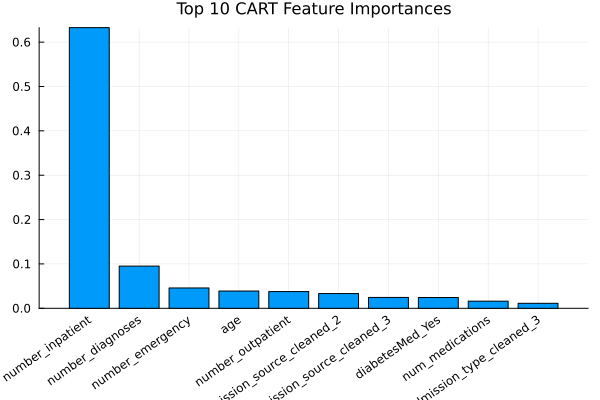

In [31]:
importances = IAI.variable_importance(best_tree_model)
sorted_importances = sort(importances, :Importance, rev=true)
top_10_importances = sorted_importances[1:10, :]
feature_names_str = string.(top_10_importances[!, :Feature])

bar(feature_names_str, top_10_importances[!, :Importance], 
    title="Top 10 CART Feature Importances", label=false,
    xrotation=35, titlefontsize = 11)

In [137]:
# ## Multi-class
# grid_cart2 = IAI.GridSearch(IAI.OptimalTreeClassifier(random_seed=seed, 
#                     localsearch=false,  
#                     max_categoric_levels_before_warning=15), 
#     criterion=:gini, max_depth = [5, 10, 15], minbucket = 50)

# IAI.fit_cv!(grid_cart2, X_train, y_train, validation_criterion = :gini, n_folds=5)

In [45]:
function calculate_and_print_scores(model, X_test, y_test, label)
    # Calculate metrics
    auc = IAI.score(model, X_test, y_test, criterion=:auc)
    acc = IAI.score(model, X_test, y_test, criterion=:misclassification)
    sensitivity = IAI.score(model, X_test, y_test, criterion=:sensitivity, positive_label = 1)
    specificity = IAI.score(model, X_test, y_test, criterion=:specificity, positive_label = 1)
    f1 = IAI.score(model, X_test, y_test, criterion=:f1score, positive_label = 1)

    results_df = DataFrame(
        Label = [label],
        AUC = [auc],
        Accuracy = [acc],
        Sensitivity = [sensitivity],
        Specificity = [specificity],
        F1_Score = [f1]
    )

    return results_df
end


calculate_and_print_scores (generic function with 1 method)

In [46]:
train_all = calculate_and_print_scores(grid_cart, X_train, y_train, "Train - All Features")
test_all = calculate_and_print_scores(grid_cart, X_test, y_test, "Test - All Features")

# Combine train and test results
combined_results = vcat(train_all, test_all)

Row,Label,AUC,Accuracy,Sensitivity,Specificity,F1_Score
,String,Float64,Float64,Float64,Float64,Float64
1,Train - All Features,0.675173,0.63011,0.520854,0.728092,0.571095
2,Test - All Features,0.669282,0.628534,0.517234,0.725321,0.564328


### CART - Boruta features

In [36]:
sub_features = [
    "age", "time_in_hospital", "num_lab_procedures", "num_procedures", 
    "num_medications", "number_outpatient", "number_emergency", "number_inpatient", 
    "number_diagnoses", "med_count_1", "med_count_2", "med_count_3", 
    "med_count_4", "med_count_6", "race_Caucasian", "race_Hispanic", 
    "race_Other", "race_Unknown", "gender_Male", "A1Cresult_>8", 
    "A1Cresult_Norm", "A1Cresult_Not Taken", "diabetesMed_Yes", 
    "med_change_1_NoMed", "med_change_1_Steady", "med_change_1_Up", 
    "med_change_2_NoMed", "med_change_2_Steady", "med_change_2_Up", 
    "med_change_3_NoMed", "med_change_3_Steady", "med_change_4_NoMed", 
    "med_change_4_Steady", "med_change_6_NoMed", "med_change_6_Steady", 
    "med_change_6_Up", "med_change_other_Yes", "discharge_group_2", 
    "discharge_group_3", "discharge_group_4", "discharge_group_7", 
    "admission_type_cleaned_1", "admission_type_cleaned_2", 
    "admission_type_cleaned_3", "admission_source_cleaned_1", 
    "admission_source_cleaned_2", "admission_source_cleaned_3", 
    "diag1_category_1", "diag1_category_2", "diag1_category_3", 
    "diag1_category_4", "diag1_category_5", "diag1_category_6", 
    "diag1_category_7", "diag1_category_8", "diag1_category_9", 
    "max_glu_serum_cleaned_>300", "max_glu_serum_cleaned_Norm", 
    "max_glu_serum_cleaned_Not Taken"
]

# Select the columns
X_train_boruta = select(X_train, sub_features)
X_test_boruta = select(X_test, sub_features);

In [37]:
grid_cart2 = IAI.GridSearch(IAI.OptimalTreeClassifier(random_seed=seed, 
                    localsearch=false,  
                    max_categoric_levels_before_warning=15), 
    criterion=:gini, max_depth = [5, 10], minbucket = [10, 50, 100])

IAI.fit_cv!(grid_cart2, X_train_boruta, y_train, validation_criterion = :auc, n_folds=5)

All Grid Results:

 Row │ minbucket  criterion  max_depth  cp           split1_train_score  split2_train_score  split3_train_score  split4_train_score  split5_train_score  mean_train_score  std_train_score  split1_valid_score  split2_valid_score  split3_valid_score  split4_valid_score  split5_valid_score  mean_valid_score  std_valid_score  split1_cp    split2_cp    split3_cp    split4_cp    split5_cp    mean_cp      std_cp      overall_valid_score  rank_valid_score
     │ Int64      Symbol     Int64      Float64      Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64             Float64             Float64             Float64             Float64             Float64           Float64          Float64      Float64      Float64      Float64      Float64      Float64      Float64     Float64              Int64
─────┼─────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │        10  gini               5  0.000122401           0.0855328           0.0833733           0.085706            0.0863607           0.0874373         0.085682        0.00149121            0.658214            0.669544            0.660239            0.655755            0.650909          0.658932       0.00687932  0.000101914  0.000120438  4.39103e-5   0.000152811  5.76086e-5   9.53363e-5   4.48461e-5             0.658904                 5
   2 │        10  gini              10  0.000166194           0.133183            0.132807            0.133682            0.133197            0.135057          0.133585        0.00087965            0.667194            0.677409            0.669291            0.664807            0.661703          0.668081       0.00592978  0.000168299  0.000263076  0.000164774  0.000194391  0.000138651  0.000185838  4.74782e-5             0.667241                 3
   3 │        50  gini               5  9.457e-5              0.0854683           0.0832975           0.0856699           0.0863456           0.0874356         0.0856434       0.00151985            0.657694            0.669449            0.660346            0.655864            0.6509            0.658851       0.00685621  0.000120606  9.457e-5     7.65153e-5   1.33605e-5   0.000107542  8.25187e-5   4.19551e-5             0.658842                 6
   4 │        50  gini              10  0.000166194           0.117487            0.115984            0.117782            0.118789            0.119045          0.117817        0.00121685            0.667488            0.677409            0.670034            0.664777            0.662084          0.668358       0.00586665  0.000168694  0.000263076  0.000165868  0.000191595  0.000158168  0.00018948   4.29849e-5             0.667662                 2
   5 │       100  gini               5  9.457e-5              0.0853964           0.083087            0.0855454           0.0863041           0.0874168         0.0855499       0.00159242            0.658006            0.669542            0.660856            0.656653            0.650901          0.659192       0.00682782  4.40428e-5   9.457e-5     7.65153e-5   1.33605e-5   4.73247e-5   5.51627e-5   3.13902e-5             0.659151                 4
   6 │       100  gini              10  0.000166188           0.110631            0.108297            0.110274            0.110873            0.111507          0.110316        0.00121493            0.668446            0.677438            0.669599            0.664832            0.66278           0.668619       0.00563917  8.17986e-5   0.000263076  9.2411e-5    0.000191153  0.000130

In [47]:
train_boruta = calculate_and_print_scores(grid_cart2, X_train_boruta, y_train, "Train - Boruta")
test_boruta = calculate_and_print_scores(grid_cart2, X_test_boruta, y_test, "Test - Boruta")

combined_results2 = vcat(combined_results, train_boruta, test_boruta)

Row,Label,AUC,Accuracy,Sensitivity,Specificity,F1_Score
,String,Float64,Float64,Float64,Float64,Float64
1,Train - All Features,0.675173,0.63011,0.520854,0.728092,0.571095
2,Test - All Features,0.669282,0.628534,0.517234,0.725321,0.564328
3,Train - Boruta,0.675173,0.63011,0.520854,0.728092,0.571095
4,Test - Boruta,0.669282,0.628534,0.517234,0.725321,0.564328


Boruta feature selection did not impact the tree - the exact same tree was built regardless of feature selection or not. 

### OCT-H

In [93]:
# Normalize continuous variables
function standardize_data(X, columns_to_standardize)
    # Convert DataFrame to matrix
    X_matrix = Matrix(X)

    filter = [in(col, columns_to_standardize) for col in names(X)]

    # Calculate the mean and standard deviation for each column
    mean_vals = mean(X_matrix[:, filter], dims=1)
    std_vals = std(X_matrix[:, filter], dims=1)

    # Standardize the selected columns
    X_matrix[:, filter] .= (X_matrix[:, filter] .- mean_vals) ./ std_vals

    return DataFrame(X_matrix, names(X))
end

continuous_variables = ["time_in_hospital", "num_lab_procedures", "num_procedures", "num_medications", "number_outpatient",
"number_emergency", "number_inpatient", "number_diagnoses", "med_count_1", "med_count_2", "med_count_3", "med_count_4", "med_count_5", "med_count_6"]
X_train_std = standardize_data(X_train, continuous_variables)
X_test_std = standardize_data(X_test, continuous_variables)

Row,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses,med_count_1,med_count_2,med_count_3,med_count_4,med_count_5,med_count_6,race_Asian,race_Caucasian,race_Hispanic,race_None,race_Other,gender_Male,gender_Unknown/Invalid,age_10-20,age_20-30,age_30-40,age_40-50,age_50-60,age_60-70,age_70-80,age_80-90,age_90-100,A1Cresult_>8,A1Cresult_None,A1Cresult_Norm,diabetesMed_Yes,med_change_1_NoMed,med_change_1_Steady,med_change_1_Up,med_change_2_Mixed,med_change_2_NoMed,med_change_2_Steady,med_change_2_Up,med_change_3_NoMed,med_change_3_Steady,med_change_3_Up,med_change_4_NoMed,med_change_4_Steady,med_change_4_Up,med_change_5_NoMed,med_change_5_Steady,med_change_5_Up,med_change_6_NoMed,med_change_6_Steady,med_change_6_Up,med_change_other_Yes,discharge_group_2,discharge_group_3,discharge_group_4,discharge_group_5,discharge_group_6,discharge_group_7,admission_type_cleaned_1,admission_type_cleaned_2,admission_type_cleaned_3,admission_type_cleaned_4,admission_type_cleaned_5,admission_source_cleaned_1,admission_source_cleaned_2,admission_source_cleaned_3,admission_source_cleaned_4,admission_source_cleaned_5,diag1_category_10,diag1_category_11,diag1_category_12,diag1_category_13,diag1_category_14,diag1_category_16,diag1_category_17,diag1_category_18,diag1_category_2,diag1_category_3,diag1_category_4,diag1_category_5,diag1_category_6,diag1_category_7,diag1_category_8,diag1_category_9,diag1_category_None,diag2_category_10,diag2_category_11,diag2_category_12,diag2_category_13,diag2_category_14,diag2_category_16,diag2_category_17,diag2_category_18,diag2_category_2,diag2_category_3,diag2_category_4,diag2_category_5,diag2_category_6,⋯
,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,⋯
1,1.89029,0.602561,-0.205742,1.83467,-0.292565,-0.247498,-0.516038,0.30743,-0.499243,-0.620393,-0.145558,-0.396932,-0.0598774,0.916656,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,⋯
2,-0.805272,0.19566,-0.792624,-0.498654,-0.292565,-0.247498,-0.516038,0.30743,-0.499243,-0.620393,-0.145558,-0.396932,-0.0598774,-1.06122,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,⋯
3,0.54251,2.23017,-0.792624,0.238185,-0.292565,-0.247498,-0.516038,0.820994,-0.499243,1.55287,-0.145558,-0.396932,16.7,0.916656,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,⋯
4,0.54251,-0.821594,-0.792624,-

In [131]:
#OCT-H
grid_oct_h = IAI.GridSearch(IAI.OptimalTreeClassifier(
        random_seed=seed,
        criterion=:gini,
        hyperplane_config=(sparsity=:all,),
        missingdatamode=:separate_class,
        max_categoric_levels_before_warning=15), max_depth = 5, minbucket=50)

IAI.fit_cv!(grid_oct_h, X_train_std, y_train, validation_criterion = :auc, n_folds=5)

LoadError: InterruptException: